# 原神观测枢分析

In [2]:
import requests
import json
from bs4 import BeautifulSoup

In [3]:
from dataclasses import dataclass
from typing import Optional

@dataclass
class Character:
    cid:int
    name:str
    icon :str
    region:str
    star:str
    weapon:str
    element:str
    birthday:Optional[str] = None
    constellation:Optional[str] = None

In [4]:
url ='https://api-static.mihoyo.com/common/blackboard/ys_obc/v1/home/content/list?app_sn=ys_obc&channel_id=189'
data = json.loads(requests.get(url).text)
characters = []
for ch in data['data']['list'][0]['children'][0]['list']:
    cid=ch['content_id']
    name = ch['title']
    if name.startswith('旅行者'):
        continue
    icon = ch['icon']
    ext=eval(json.loads(ch['ext'])['c_25']['filter']['text'])
    region=next(x for x in ext if x.startswith('地区')).split('/')[-1]
    weapon = next(x for x in ext if x.startswith('武器')).split('/')[-1]
    element = next(x for x in ext if x.startswith('元素')).split('/')[-1]
    star = next(x for x in ext if x.startswith('星级')).split('/')[-1]
    char  = Character(cid,name,icon,region,star,weapon,element)
    characters.append(char)

In [5]:
from tqdm import tqdm

def get_birthday_constellation(cid:int):
    url = f'https://api-static.mihoyo.com/common/blackboard/ys_obc/v1/content/info?app_sn=ys_obc&content_id={cid}'
    data= json.loads(requests.get(url).text)
    html=data['data']['content']['contents'][0]['text']
    soup = BeautifulSoup(html,'html.parser')
    divs =  soup.select('div.obc-tmp-character__value')
    return divs[0].text,divs[4].text

for ch in tqdm(characters):
    ch.birthday,ch.constellation= get_birthday_constellation(ch.cid)

100%|██████████| 58/58 [00:18<00:00,  3.14it/s]


 34%|███▍      | 20/58 [00:02<00:05,  6.38it/s]C:\Users\31815\AppData\Local\Temp\ipykernel_16264\1995508512.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))
100%|██████████| 58/58 [00:08<00:00,  6.84it/s]


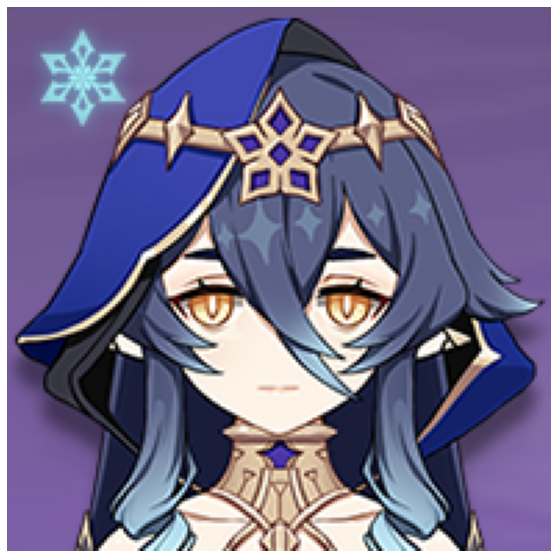

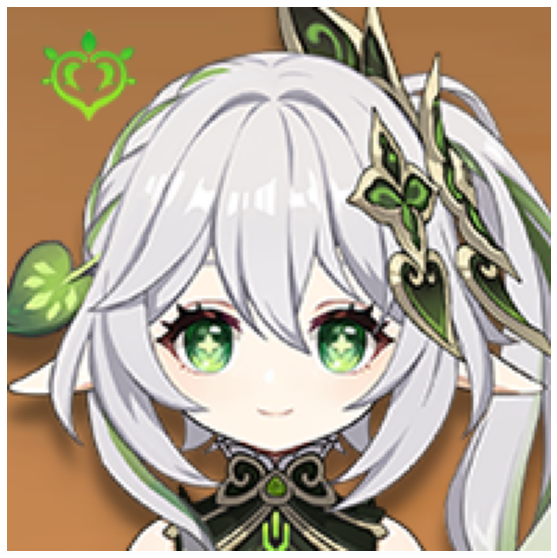

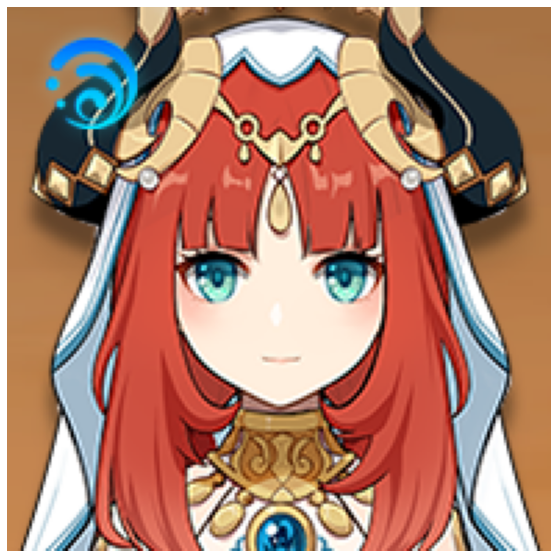

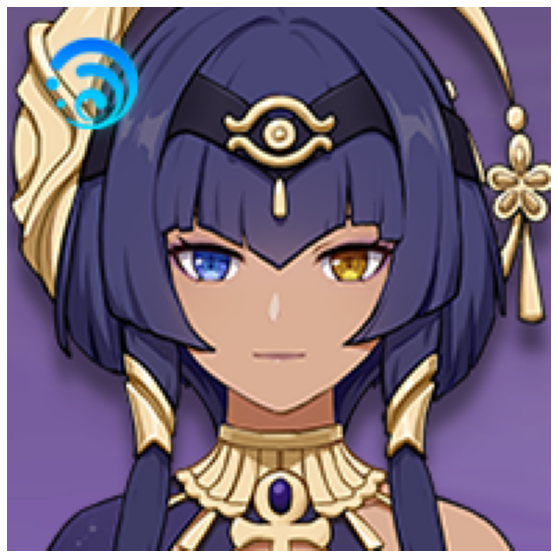

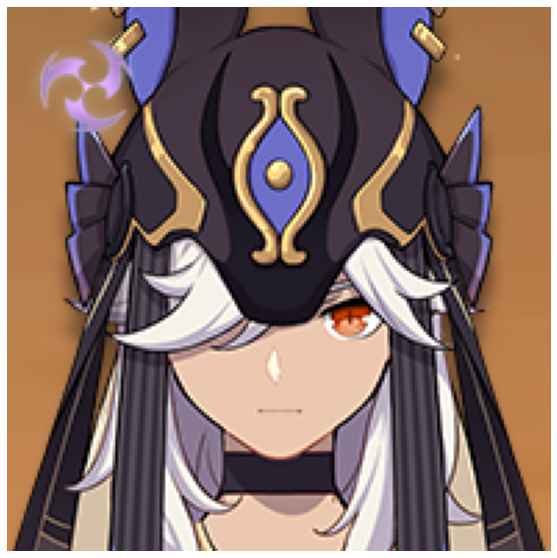

...

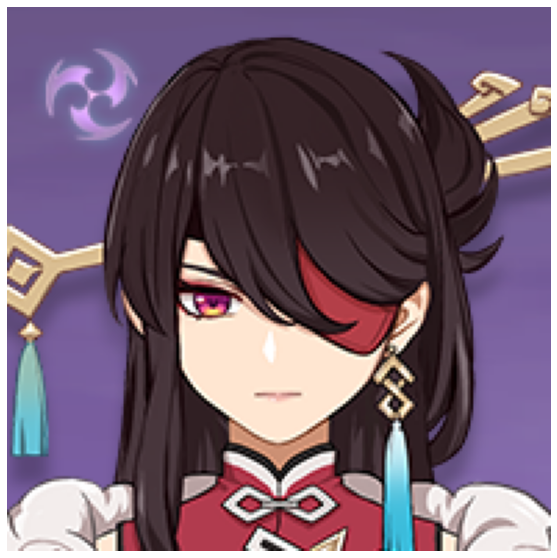

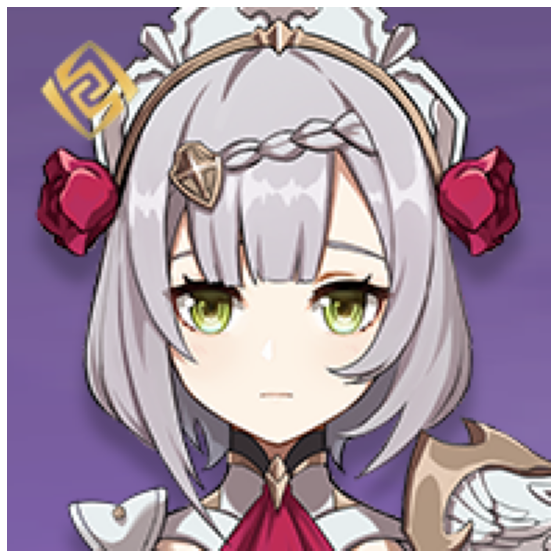

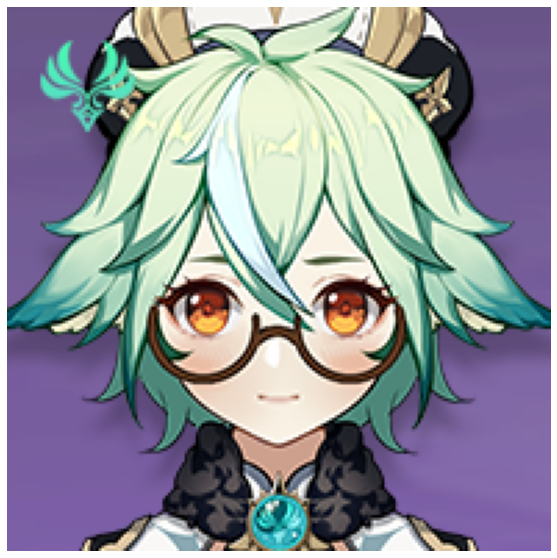

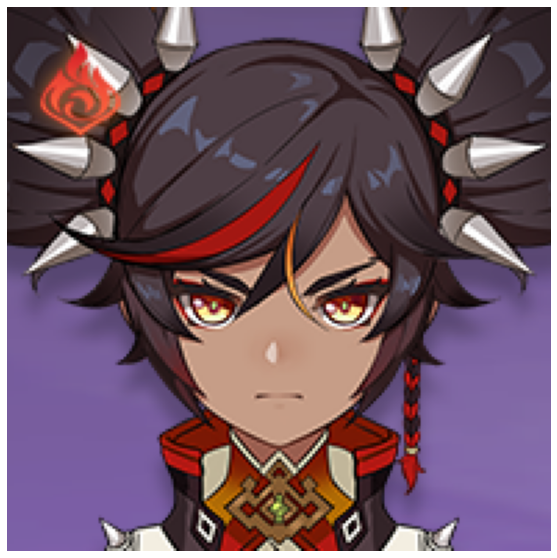

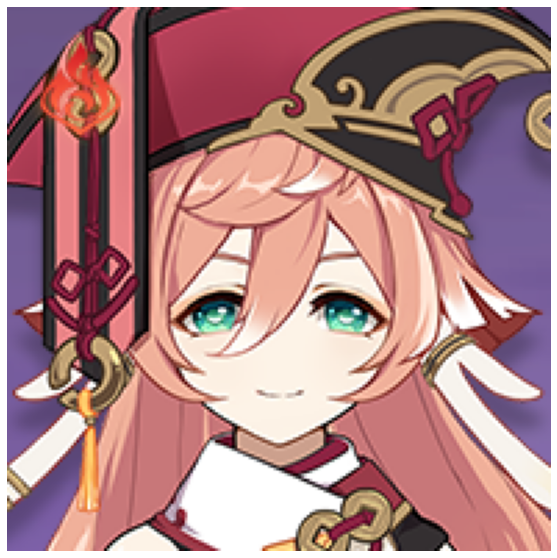

In [6]:
from matplotlib import pyplot as plt
import pandas as pd
import seaborn as sns
from PIL import Image
import numpy as np

for ch in tqdm(characters):
    img = np.asarray(Image.open(requests.get(ch.icon,stream=True).raw))
    plt.figure(figsize=(10,10))
    plt.axis(False)
    plt.imshow(img)

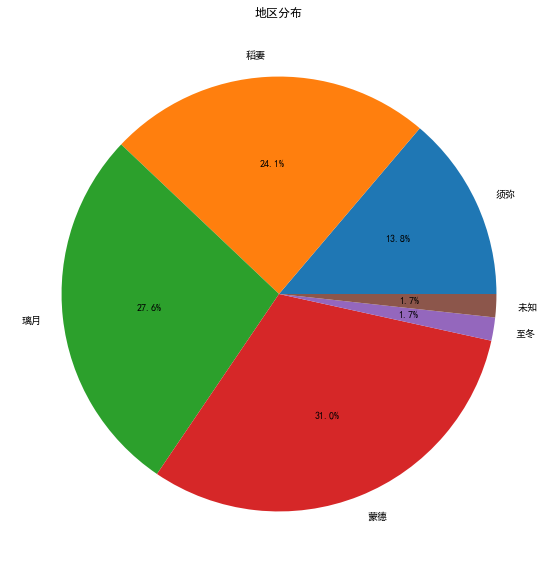

In [20]:
from collections import Counter

# 解决中文显示问题
plt.rcParams['font.sans-serif'] = ['SimHei']
# 地区分布
cnt = Counter([ch.region for ch in characters])
plt.figure(figsize=(10,10))
plt.title('地区分布')
plt.pie(cnt.values(),labels=cnt.keys(),autopct='%1.1f%%')
# sns.barplot(x=list(cnt.keys()),y=list(cnt.values()))
plt.show()

<AxesSubplot:title={'center':'星级分布'}>

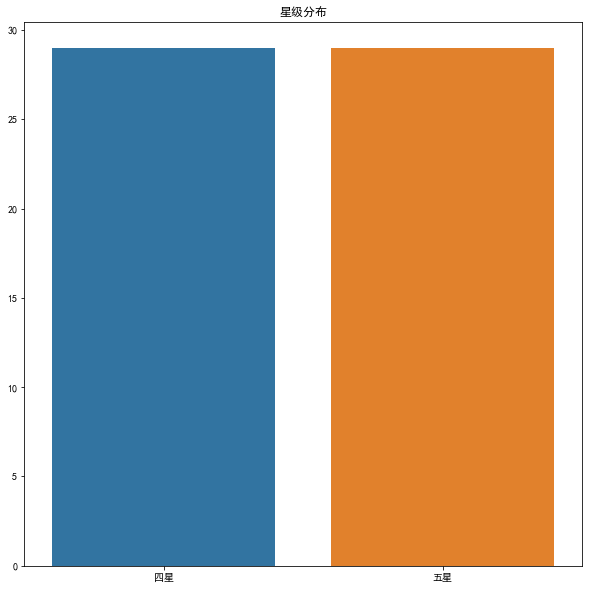

In [18]:
# 星级分布
cnt = Counter([ch.star for ch in characters])
plt.figure(figsize=(10,10))
plt.title('星级分布')
# 柱状图
sns.barplot(x=list(cnt.keys()),y=list(cnt.values()))

<AxesSubplot:title={'center':'元素分布'}>

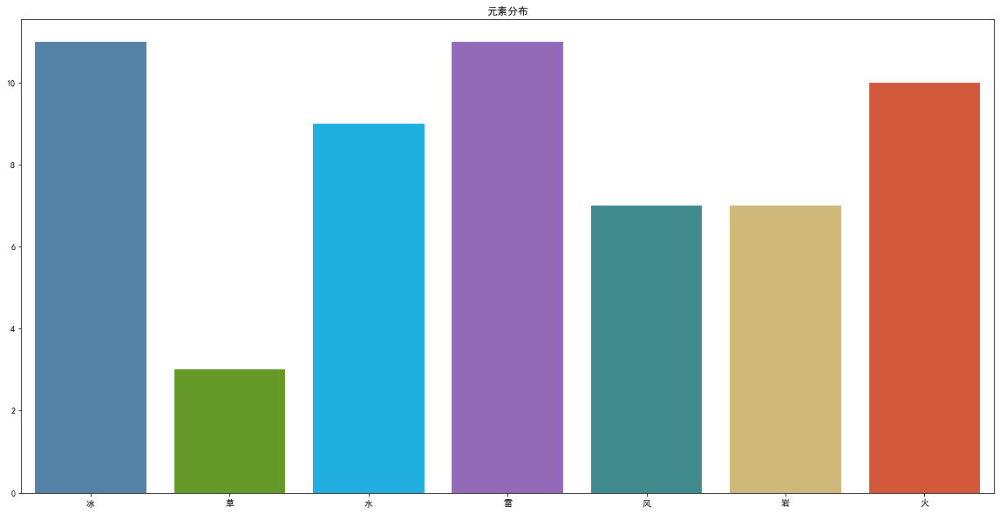

In [27]:
# 元素分布
cnt = Counter([ch.element for ch in characters])
plt.figure(figsize=(20,10))
plt.title('元素分布')
# 为每个元素分配不同的颜色
colors = ['#4682B4','#66AD16','#00BFFF','#945DC4','#359697','#DEBD6C','#EC4923']
sns.barplot(x=list(cnt.keys()),y=list(cnt.values()),palette=colors)

<AxesSubplot:title={'center':'武器分布'}>

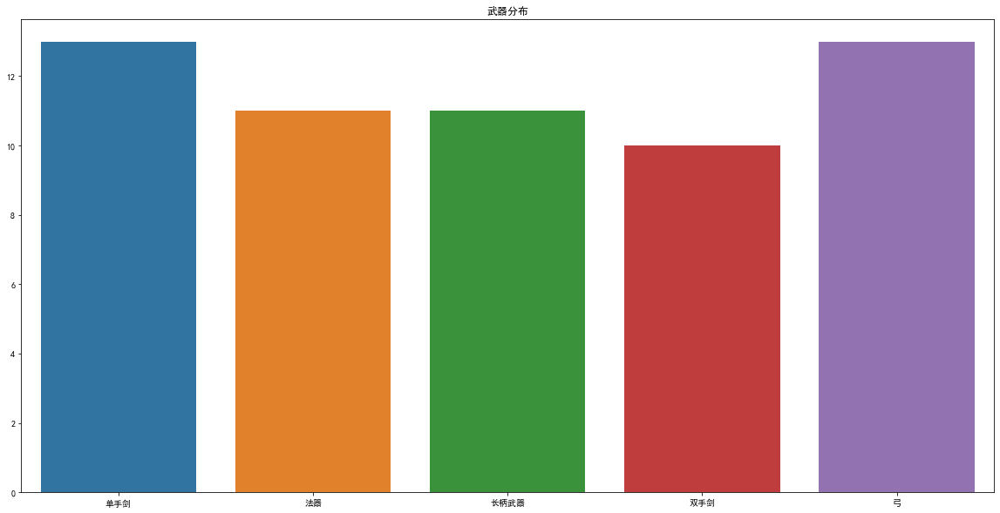

In [28]:
# 武器分布
cnt = Counter([ch.weapon for ch in characters])
plt.figure(figsize=(20,10))
plt.title('武器分布')
sns.barplot(x=list(cnt.keys()),y=list(cnt.values()))

<AxesSubplot:title={'center':'生日分布'}>

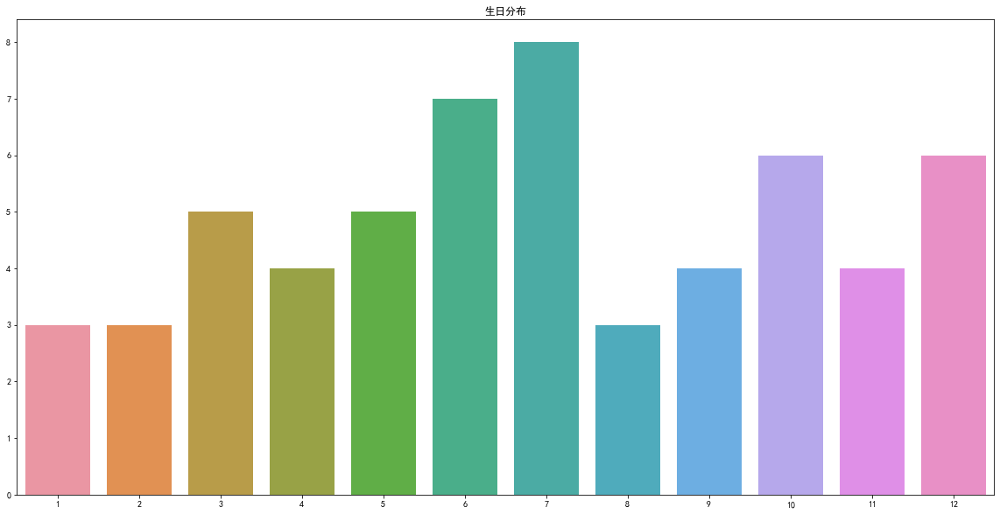

In [33]:
# 生日分布
cnt = Counter([int(ch.birthday.split('月')[0]) for ch in characters])
plt.figure(figsize=(20,10))
plt.title('生日分布')
sns.barplot(x=list(cnt.keys()),y=list(cnt.values()))

In [35]:
# 制作charactors的dataframe
df = pd.DataFrame([ch.__dict__ for ch in characters])
df

,cid,name,icon,region,star,weapon,element,birthday,constellation
0,5297,莱依拉,https://uploadstatic.mihoyo.com/ys-obc/2022/10...,须弥,四星,单手剑,冰,12月19日,夜莺座
1,5111,纳西妲,https://uploadstatic.mihoyo.com/ys-obc/2022/10...,须弥,五星,法器,草,10月27日,智慧主座
2,5020,妮露,https://uploadstatic.mihoyo.com/ys-obc/2022/10...,须弥,五星,单手剑,水,12月3日,睡莲座
3,4781,坎蒂丝,https://uploadstatic.mihoyo.com/ys-obc/2022/09...,须弥,四星,长柄武器,水,5月3日,箭盾座
4,4780,赛诺,https://uploadstatic.mihoyo.com/ys-obc/2022/09...,须弥,五星,长柄武器,雷,6月23日,金狼座
5,4736,多莉,https://uploadstatic.mihoyo.com/ys-obc/2022/09...,须弥,四星,双手剑,雷,12月21日,神灯座
6,4334,提纳里,https://uploadstatic.mihoyo.com/ys-obc/2022/08...,须弥,五星,弓,草,12月29日,郭狐座
7,4333,柯莱,https://uploadstatic.mihoyo.com/ys-obc/2022/08...,须弥,四星,弓,草,5月8日,薮猫座
8,4197,鹿野院平藏,https://uploadstatic.mihoyo.com/ys-obc/2022/07...,稻妻,四星,法器,风,7月24日,幼鹿座
9,4148,久岐忍,https://uploadstatic.mihoyo.com/ys-obc/2022/05...,稻妻,四星,单手剑,雷,7月27日,烦恼刈座


In [36]:
# 保存为csv文件
df.to_csv('characters.csv',index=False)

In [37]:
# 保存为excel文件
df.to_excel('characters.xlsx',index=False)